### Stanford campus dataset overview
Here described some important notes about dataset related to segmentation task
* In total there are 60 videos, scenes differ little from each other.


In [18]:
import os
import cv2
import datetime

import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
from PIL import Image

In [10]:
data_dir = "data/"
vid_dir = os.path.join(data_dir, "videos")
vid_paths = []
for root, dirs, files in os.walk(vid_dir):
    path = root.split(os.sep)
    for file in files:
        if file.endswith(".mov"):
            vid_paths.append(os.path.join(root,file))
vid_duration_map = {}
vid_frames_map = {}
for vid_path in vid_paths:
    vid = cv2.VideoCapture(vid_path)
    # count the number of frames
    frames_cnt = vid.get(cv2.CAP_PROP_FRAME_COUNT)
    fps = int(vid.get(cv2.CAP_PROP_FPS))

    # calculate dusration of the video
    seconds = int(frames_cnt / fps)
    video_time = str(datetime.timedelta(seconds=seconds))
    vid_duration_map[vid_path]=seconds
    vid.set(cv2.CAP_PROP_POS_FRAMES,100)
    _,frame = vid.read()
    vid_frames_map[vid_path] = frame

durations = list(vid_duration_map.values())
frames = list(vid_frames_map.values())
heights = [ im.shape[0] for im in frames]
widths = [ im.shape[1] for im in frames]

print("\nVideo durations statistics (sec):")
print(pd.Series(durations).describe())

print("\nVideo widths statistics (pixels):")
print(pd.Series(widths).describe())

print("\nVideo heights statistics (pixels):")
print(pd.Series(heights).describe())


Video durations statistics (sec):
count     60.000000
mean     299.833333
std      181.546293
min       14.000000
25%       74.000000
50%      379.500000
75%      437.000000
max      502.000000
dtype: float64

Video widths statistics (pixels):
count      60.000000
mean     1455.883333
std       218.995944
min      1184.000000
25%      1325.000000
50%      1416.000000
75%      1434.500000
max      1983.000000
dtype: float64

Video heights statistics (pixels):
count      60.000000
mean     1573.866667
std       483.755032
min       741.000000
25%      1088.000000
50%      1932.500000
75%      1973.000000
max      2019.000000
dtype: float64


* Videos have very different durations (mean ~ 5 min) and very different resolutions (from 740x1180 to 2020x1983)

* Frame examples from each video:

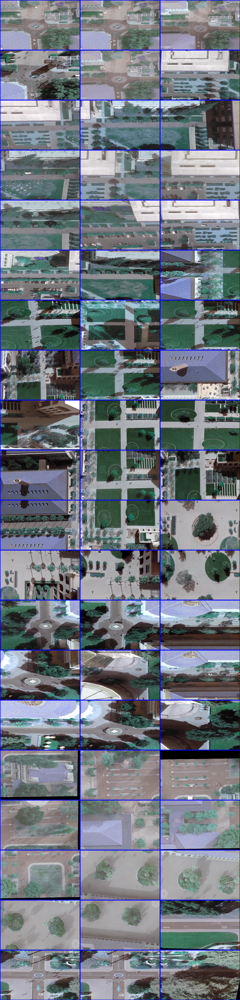

In [11]:
frames_rszd = [cv2.resize(im, (480, 300)) for im in frames ]
ims_to_show = []
for i in range(20):
    im_line =[ ]
    for j in range(3):
        im = frames_rszd[i*3+j]
        im = cv2.rectangle(im,(0,0),(im.shape[1], im.shape[0]),(0,0,255),4)
        im_line.append(im)
    im_line=np.hstack(im_line)
    ims_to_show.append(im_line)
    # plt.imshow(ims_to_show[-1])
# from IPython.display import Image

img = Image.fromarray(np.vstack(ims_to_show))
img

* There are strange artifacts in some videos, usually they appear in the beginning or in the end, but sometimes in also in the middle of the video


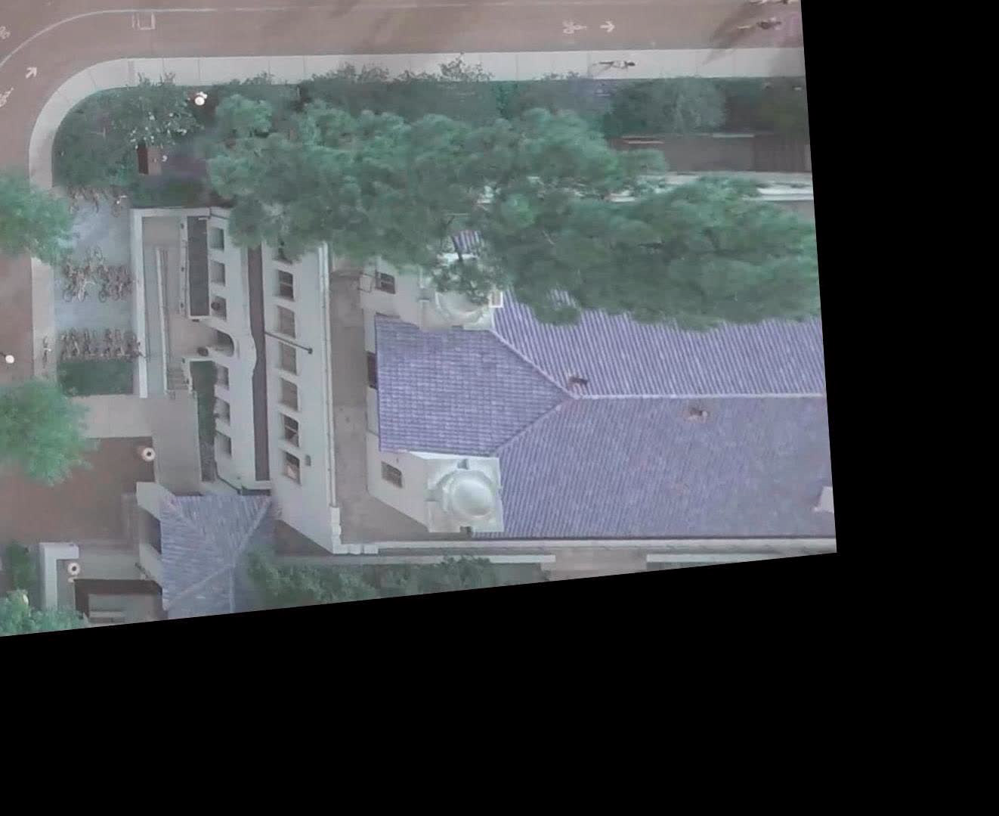

In [31]:
sample_vid_path = os.path.join(vid_dir,"bookstore/video4/video.mov")
sample_vid = cv2.VideoCapture(sample_vid_path)
_,frame = vid.read()
Image.fromarray(frame)


* The position of the drone is not very stable, sometimes there is a rather huge drift during the video. Here is an example:

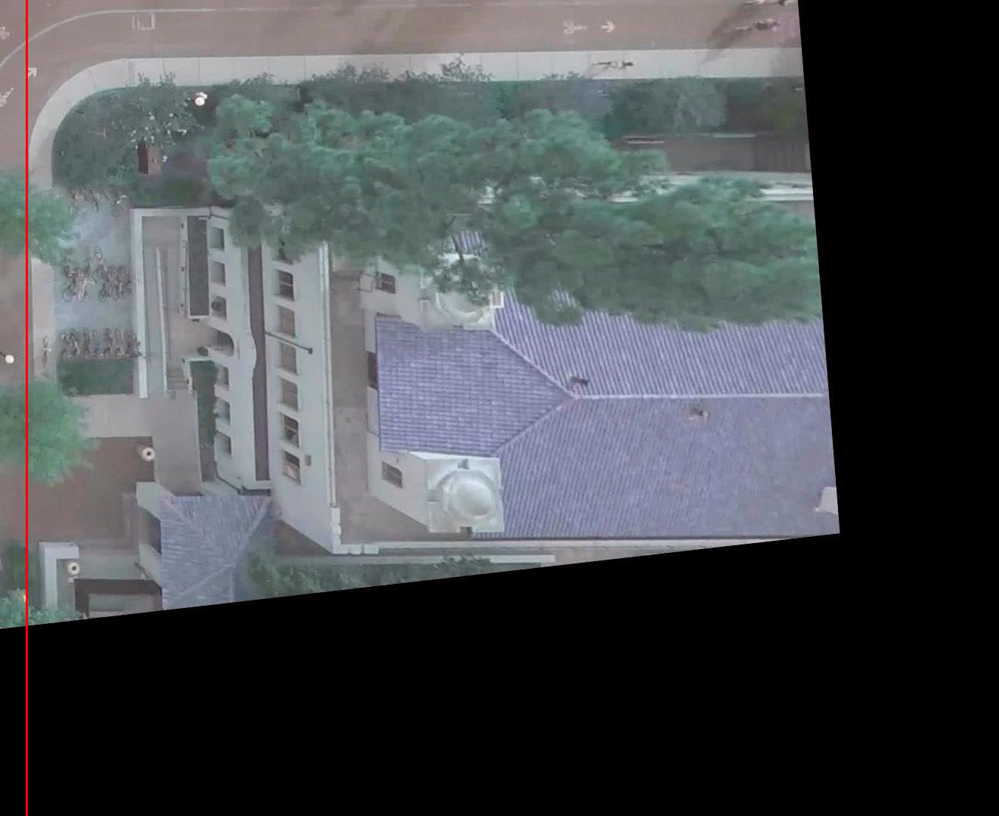

In [36]:
vid = cv2.VideoCapture(os.path.join(vid_dir,"bookstore/video4/video.mov"))
_,frame = vid.read()
frame = cv2.line(frame,(35,0),(35,frame.shape[1]),(255,0,0),2)
Image.fromarray(frame)

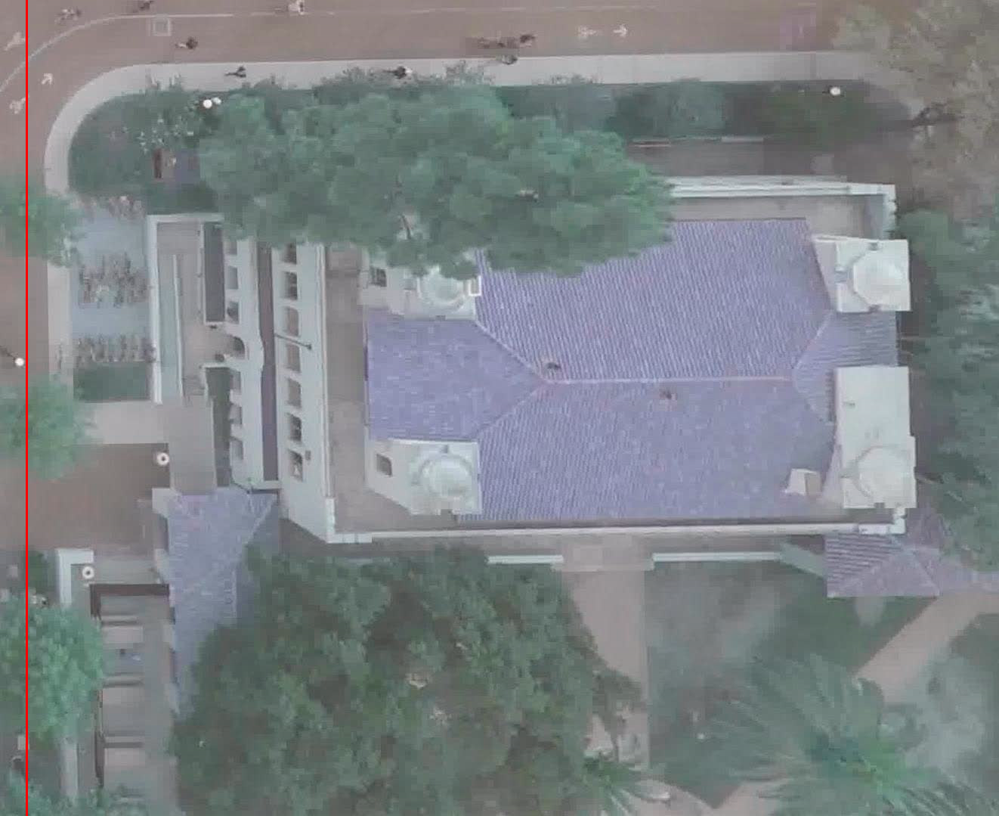

In [40]:
vid.set(cv2.CAP_PROP_POS_FRAMES,10800)
_,frame = vid.read()
frame = cv2.line(frame,(35,0),(35,frame.shape[1]),(255,0,0),2)
Image.fromarray(frame)

* Some scenes are very sunny and objects have very clear shadows:

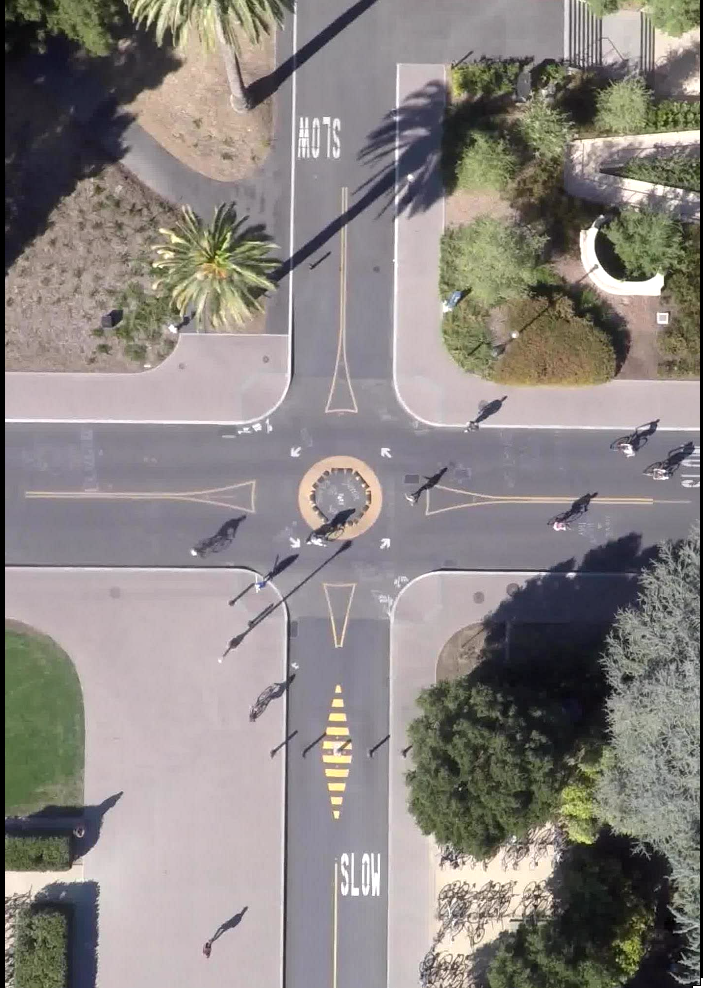

In [41]:
from IPython.display import Image
Image(filename='ipnb_imgs/Screenshot_20210415_035212.png')

#### Annotations
* Annotations bonding boxes are not very tight, and some of them jitter a lot
* There are occluded annotations (e.g. the man under the tree)
* Shadows could partly get into bonding boxes

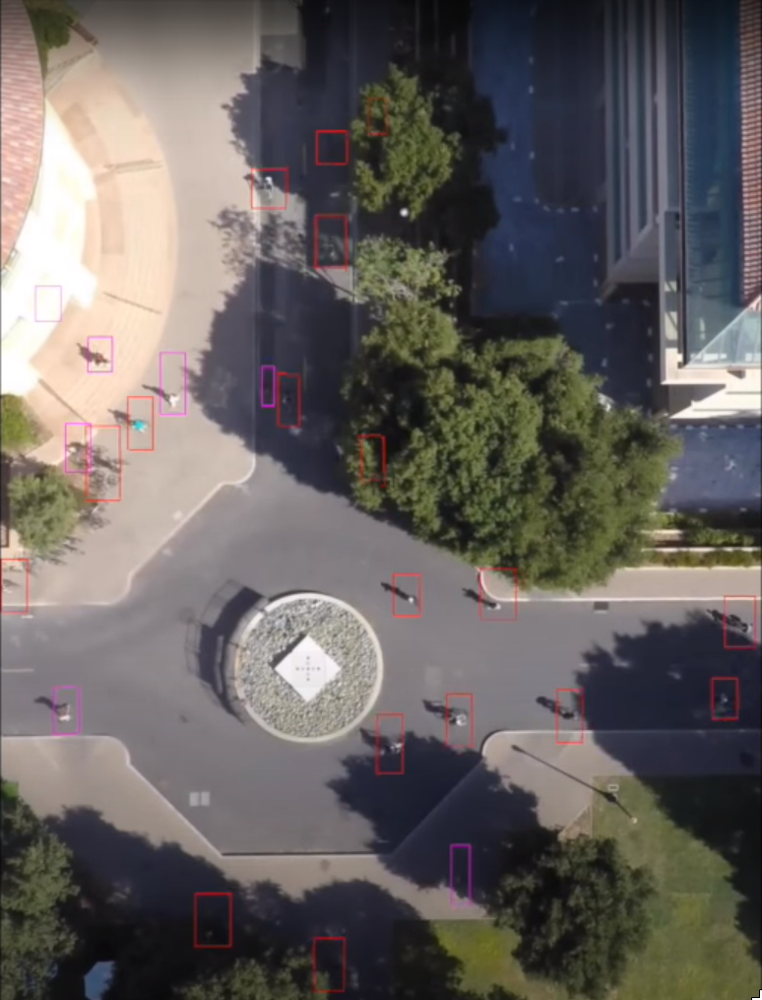

In [43]:
from IPython.display import Image
Image(filename='ipnb_imgs/Screenshot_20210415_040200.png')

* Sometimes one object changes class during the video (e.g. the man under the tree)


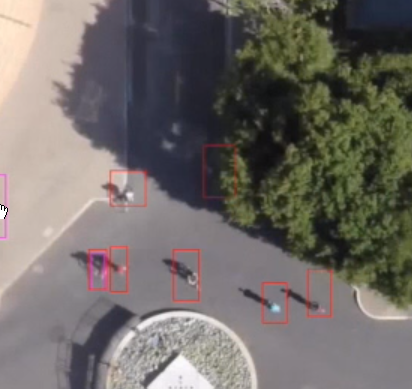

In [44]:
from IPython.display import Image
Image(filename='ipnb_imgs/Screenshot_20210415_040626.png')

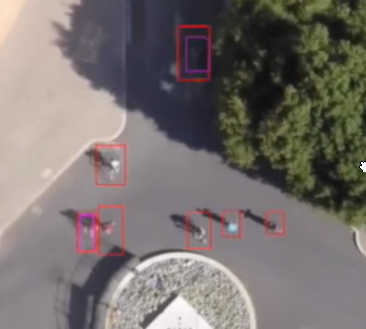

In [45]:
from IPython.display import Image
Image(filename='ipnb_imgs/Screenshot_20210415_040708.png')